In [1]:
%runfile H3.py

In [2]:
from utils import (make_M_alphas, 
                   make_poly_from_edges, 
                   poly_equiv, tri0, tri1, tri2, cycle_poly, std_poly,
                   poly_gl2_orbit_reps, 
                   aas_triangle_gl2_orbit_reps, 
                   square_parameters, 
                   aaa_triangle_parameters, 
                   aas_triangle_parameters,
                   hexagon_parameters)
from polyhedra import all_poly_types, poly_type, poly_types

In [3]:
kdata = make_k(13)
k = kdata['k']
w = kdata['w']
zero = k(0)
one = k(1)
Ireps = kdata['Ireps']
inf = cusp(infinity, k)
k.class_number()

2

In [4]:
alphas = precomputed_alphas(k)
M_alphas, alpha_inv = make_M_alphas(alphas)
print("{} alphas".format(len(alphas)))

sigmas = [cusp(s,k) for s in [oo, (w+1)/(2)]]
print("{} sigmas".format(len(sigmas)))

16 alphas
2 sigmas


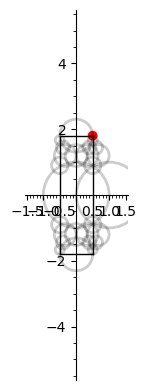

In [5]:
plot_FunDomain_projection(k, alphas, sigmas)

In [6]:
polys, hemis = all_polyhedra(k)
print("{} polyhedra constructed".format(len(polys)))

New orbit from P_0=[7/16*w + 1/2, 3/256]: {0, 1}
New orbit from P_2=[-4/9*w - 4/9, 1/81]: {2, 3, 4, 5}
New orbit from P_6=[7/26*w + 1/6, 7/234]: {11, 6, 7}
New orbit from P_8=[-7/26*w - 1/6, 7/234]: {8, 9, 10}
New orbit from P_12=[10/39*w + 1/3, 4/117]: {16, 17, 12, 15}
New orbit from P_13=[-10/39*w - 1/3, 4/117]: {18, 19, 13, 14}
New orbit from P_20=[-5/13*w - 1/6, 23/468]: {24, 20, 21}
New orbit from P_22=[5/13*w + 1/6, 23/468]: {25, 22, 23}
New orbit from P_26=[3/13*w + 1/2, 3/52]: {26}
New orbit from P_27=[-3/13*w + 1/2, 3/52]: {27}
Found 10 orbits
Orbits:
[25, 22, 23]
[11, 6, 7]
[0, 1]
[27]
[26]
[24, 20, 21]
[2, 3, 4, 5]
[8, 9, 10]
[16, 17, 12, 15]
[18, 19, 13, 14]
Constructed 10 polyhedra
Faces: [[4, 3, 4, 3, 4], [6, 4, 3, 4, 3, 4, 3, 3], [3, 4, 4, 4, 3], [4, 4, 3, 4, 3], [4, 4, 3, 4, 3], [4, 3, 4, 3, 4], [4, 4, 4, 4, 4, 4], [3, 4, 4, 3, 4, 3, 3, 6], [4, 4, 4, 4, 4, 4], [4, 4, 4, 4, 4, 4]]
New orbit from R_0=[13/28*w + 13/28, 1/56]: {0, 1, 2, 3}
Found 1 orbits with representative

In [7]:
poly_types(polys)

{'tetrahedron': 0,
 'cube': 3,
 'octahedron': 0,
 'triangular prism': 5,
 'square prism': 1,
 'hexagonal prism': 0,
 'hexagonal cap': 2,
 'truncated tetrahedron': 0,
 'cuboctahedron': 0,
 'unknown': 0}

In [8]:
all_poly_types(polys)

['triangular prism',
 'hexagonal cap',
 'triangular prism',
 'triangular prism',
 'triangular prism',
 'triangular prism',
 'cube',
 'hexagonal cap',
 'cube',
 'cube',
 'square prism']

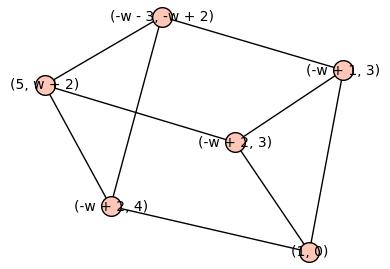

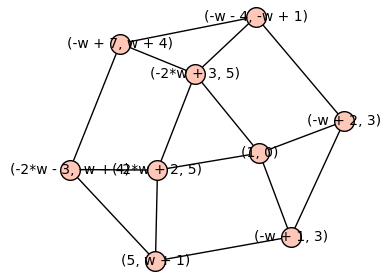

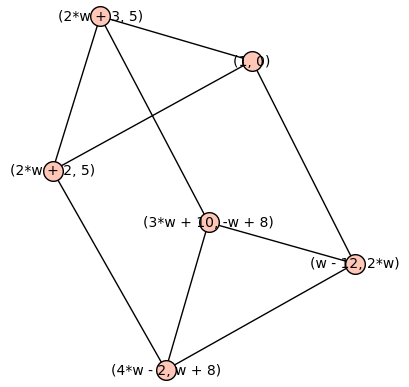

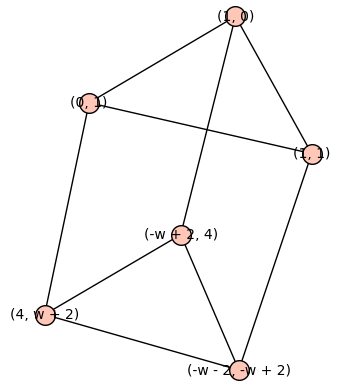

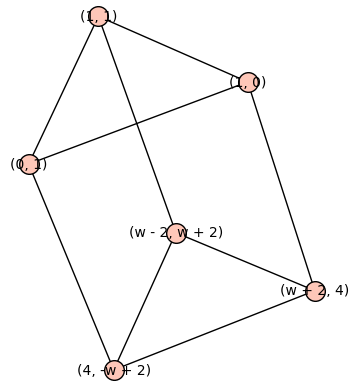

...

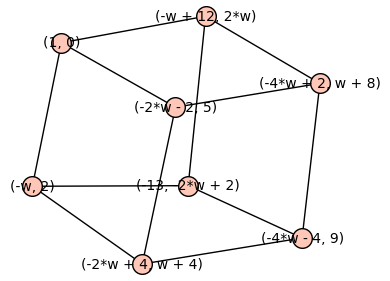

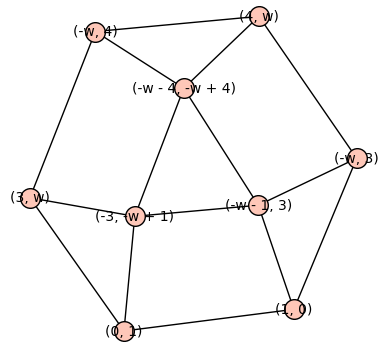

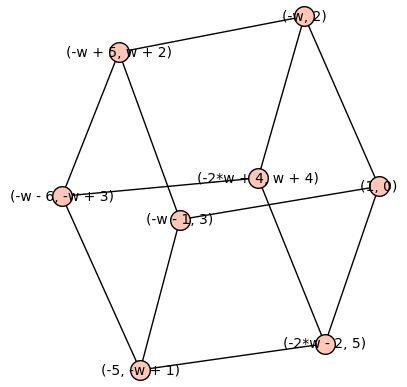

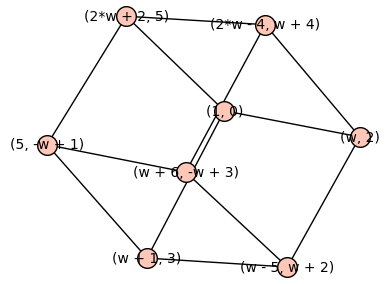

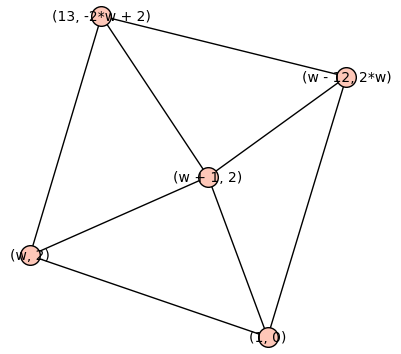

In [9]:
assert len(polys)==11
for G in polys: show(G)

In [10]:
triangles = [make_poly_from_edges(t,k) for t in sum([[F for F in G.faces() if len(F)==3] for G in polys],[])]
squares = [make_poly_from_edges(t,k) for t in sum([[F for F in G.faces() if len(F)==4] for G in polys],[])]
hexagons = [make_poly_from_edges(t,k) for t in sum([[F for F in G.faces() if len(F)==6] for G in polys],[])]
aaa_triangles = [T for T in triangles if is_poly_principal(T)]
aas_triangles = [T for T in triangles if not is_poly_principal(T)]

In [11]:
[len(t) for t in [aaa_triangles, aas_triangles, squares, hexagons]]

[18, 4, 40, 2]

In [12]:
aaa_triangles0 = poly_gl2_orbit_reps(aaa_triangles, alphas)
aas_triangles0 = aas_triangle_gl2_orbit_reps(aas_triangles, alphas)
squares0 = poly_gl2_orbit_reps(squares, alphas)
hexagons0 = poly_gl2_orbit_reps(hexagons, alphas)

In [13]:
[len(t) for t in [aaa_triangles0, aas_triangles0, squares0, hexagons0]]

[3, 2, 7, 1]

In [14]:
[square_parameters(S, alphas, M_alphas, alpha_inv) for S in squares0]

13 Q 1 6 11 7 1 0 0 0 0 0
13 Q 2 1 2 1 0 0 0 0 0 0
13 Q 6 13 7 0 0 0 0 0 0 0
13 Q 8 14 9 15 -1 0 -1 0 0 0
13 Q 11 0 11 0 1 0 -1 0 0 0
13 Q 9 1 8 1 0 1 0 0 -1 -1
13 Q 1 12 1 12 0 0 0 0 0 0


[[[1, 6, 11, 7], [1, 0, 0]],
 [[2, 1, 2, 1], [0, 0, 0]],
 [[6, 13, 7, 0], [0, 0, 0]],
 [[8, 14, 9, 15], [-1, -1, 0]],
 [[11, 0, 11, 0], [1, -1, 0]],
 [[9, 1, 8, 1], [w, 0, -w - 1]],
 [[1, 12, 1, 12], [0, 0, 0]]]

In [15]:
[aas_triangle_parameters(T, alphas, M_alphas, sigmas) for T in aas_triangles0]

13 U 8 1 1 0 0
13 U 1 1 1 0 0


[[[8, 1, 1], 0], [[1, 1, 1], 0]]

In [16]:
triangles1 = [T for T in aaa_triangles0 if not any(poly_equiv(T, t) for t in [tri0(k), tri1(k), tri2(k)])]
triangles1

[[[w + 1:-3], oo, [w + 2:-3]], [[2*w - 2:-5], oo, [-2*w + 3:5]]]

In [17]:
[aaa_triangle_parameters(T, alphas, M_alphas) for T in triangles1]

13 T 4 2 5 0 0
13 T 14 12 14 -1 0


[[[4, 2, 5], 0], [[14, 12, 14], -1]]

In [18]:
[hexagon_parameters(H, alphas, M_alphas) for H in hexagons0]

13 H 0 2 2 0 0 2 0 0 0 0 0 0 0 0 0 0


[[[0, 2, 2, 0, 0, 2], [0, 0, 0, 0, 0]]]

In [19]:
plot_Bianchi_diagram(k,hemis)

Graphics3d Object